In [3]:
import numpy as np
#import mdtraj as md
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from mpl_toolkits import mplot3d
#import nglview as nv
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
#import plotly.express as px

In [1]:
import torch
import torch.nn as nn
import numpy as np
import math
import re, shutil, tempfile
import sys
import os
from sklearn.decomposition import PCA
import subprocess

In [2]:
inputPIV = np.load("../r0_to_r2_C45.npy")
model = torch.load("lightning_logs/version_4537752/checkpoints/d3.ckpt", map_location=torch.device('cpu'))

Eweights0= model['state_dict']['encoder.0.weight']
Ebias0= model['state_dict']['encoder.0.bias']
Eweights0g = np.asarray(Eweights0)
Ebias0g = np.asarray(Ebias0)

Eweights2= model['state_dict']['encoder.3.weight']
Ebias2= model['state_dict']['encoder.3.bias']
Eweights3 = np.asarray(Eweights2)
Ebias3 = np.asarray(Ebias2)

Eweights0= model['state_dict']['encoder.6.weight']
Ebias0= model['state_dict']['encoder.6.bias']
Eweights6 = np.asarray(Eweights0)
Ebias6 = np.asarray(Ebias0)

Eweights2= model['state_dict']['encoder.9.weight']
Ebias2= model['state_dict']['encoder.9.bias']
Eweights9 = np.asarray(Eweights2)
Ebias9 = np.asarray(Ebias2)

weights2= np.asarray(model['state_dict']['encoder.2.weight'])
bias2= np.asarray(model['state_dict']['encoder.2.bias'])
mu2= np.asarray(model['state_dict']['encoder.2.running_mean'])
var2= np.sqrt(np.asarray(model['state_dict']['encoder.2.running_var']) + 0.00001)

weights5= np.asarray(model['state_dict']['encoder.5.weight'])
bias5= np.asarray(model['state_dict']['encoder.5.bias'])
mu5= np.asarray(model['state_dict']['encoder.5.running_mean'])
var5= np.sqrt(np.asarray(model['state_dict']['encoder.5.running_var']) + 0.00001)

weights8= np.asarray(model['state_dict']['encoder.8.weight'])
bias8= np.asarray(model['state_dict']['encoder.8.bias'])
mu8= np.asarray(model['state_dict']['encoder.8.running_mean'])
var8= np.sqrt(np.asarray(model['state_dict']['encoder.8.running_var']) + 0.00001)

weights11= np.asarray(model['state_dict']['encoder.11.weight'])
bias11= np.asarray(model['state_dict']['encoder.11.bias'])
mu11= np.asarray(model['state_dict']['encoder.11.running_mean'])
var11= np.sqrt(np.asarray(model['state_dict']['encoder.11.running_var']) + 0.00001)

pca_comps = np.asarray([[0.15235914, -0.6859886 , 0.7114818], [-0.89987606, -0.3939572,
       -0.18713872], [0.40866837, -0.6117331 , -0.6773277]])




E_H1 = ((np.tanh(np.dot(inputPIV,Eweights0g.T) + Ebias0g) - mu2)/var2)*weights2 + bias2
E_H2 = ((np.tanh(np.dot(E_H1,Eweights3.T) + Ebias3) - mu5)/var5)*weights5 + bias5
E_H3 = ((np.tanh(np.dot(E_H2,Eweights6.T) + Ebias6) - mu8)/var8)*weights8 + bias8
Latent = ((np.tanh(np.dot(E_H3,Eweights9.T) + Ebias9) - mu11)/var11)*weights11 + bias11
pcaLatent = np.dot(Latent,pca_comps.T)
#Latent = np.tanh(np.dot(E_H1,Eweights2.T) + Ebias2)
#PCA_Latent = np.dot(Latent,pca_weights.T)

In [5]:
np.shape(pcaLatent)

(95000, 3)

In [4]:
pcaLatent = pcaLatent[1:]

In [6]:
np.save("r0tor2_projOn_r0_c45", pcaLatent)

In [6]:
trj = md.load("md_whole.xtc", top="md_whole.gro")

In [7]:
princ_comp = md.principal_moments(trj)

In [8]:
princ_comp = princ_comp[5000:30000]

(array([  1.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          2.,   3.,   1.,   1.,   0.,   3.,   5.,   2.,   6.,   4.,   7.,
          2.,   7.,   6.,  11.,  21.,  24.,  23.,  18.,  19.,  24.,  28.,
         45.,  40.,  55.,  61.,  62.,  69.,  97.,  96., 104., 115., 136.,
        164., 184., 205., 212., 256., 286., 276., 318., 379., 421., 462.,
        444., 539., 547., 620., 616., 664., 718., 769., 787., 843., 837.,
        922., 853., 854., 876., 854., 858., 807., 806., 791., 759., 696.,
        648., 574., 479., 448., 412., 324., 269., 244., 209., 172., 137.,
        106.,  75.,  53.,  44.,  32.,  15.,  10.,  15.,   6.,   2.,   3.,
          1.]),
 array([3.97305511, 3.97429901, 3.97554291, 3.9767868 , 3.9780307 ,
        3.9792746 , 3.9805185 , 3.98176239, 3.98300629, 3.98425019,
        3.98549408, 3.98673798, 3.98798188, 3.98922578, 3.99046967,
        3.99171357, 3.99295747, 3.99420136, 3.99544526, 3.99668916,
        3.99793305, 3.99917695, 4.00042085, 4.

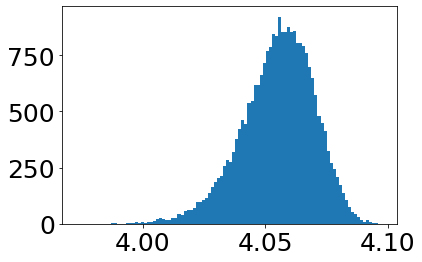

In [14]:
plt.hist(princ_comp.T[0], bins=100)

In [8]:
min(latent.T[2])

-2.601664

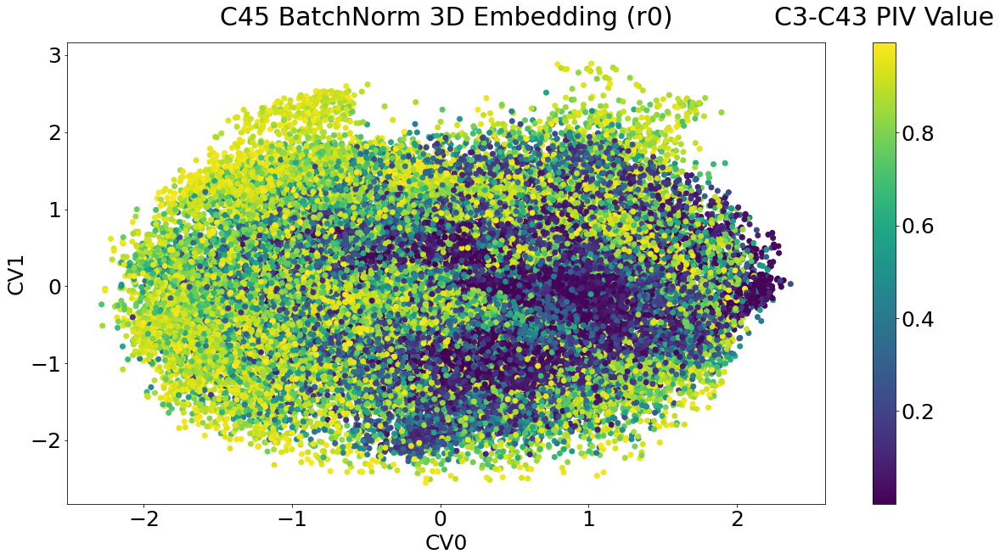

In [22]:
inputPIV = np.load("../r_c45_wPCA/PIV_C45_r7_wPCA.npy")
latent = np.load("../r7_c45_wPCA/3d_LatentSpace.npy")
pca = PCA()
pca.fit(latent)
projected_latentspace = pca.transform(latent)

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
s1 = axes.scatter(projected_latentspace.T[1], projected_latentspace.T[2], c=inputPIV.T[7])
#s1 = axes.scatter(latent.T[1], latent.T[2], c=inputPIV.T[7])
#axes.scatter(projected_latentspace.T[0][5075], projected_latentspace.T[1][5075], c="red")
clb = plt.colorbar(s1)
clb.ax.set_title("C3-C43 PIV Value", pad=20)
plt.rcParams.update({'font.size': 25})
axes.set_title("C45 BatchNorm 3D Embedding (r0)",pad=20)
axes.set_ylabel("CV1")
axes.set_xlabel("CV0")
plt.show()

In [23]:
pca.components_

array([[-0.5772503 ,  0.0274175 ,  0.8161069 ],
       [ 0.09157938, -0.99095714,  0.09806767],
       [ 0.81141573,  0.13134824,  0.5695194 ]], dtype=float32)

In [2]:
inputPIV = np.load("PIV_r0_50k.npy")
latent = np.load("3d_LatentSpace.npy")
pca = PCA()
pca.fit(latent)
projected_latentspace = pca.transform(latent)

fig, axes = plt.subplots(1, 1, figsize=(20, 10))
#s1 = axes.scatter(projected_latentspace.T[0], projected_latentspace.T[1], c=NaCl_distances, vmax=1.0)
s1 = axes.scatter(projected_latentspace.T[1], projected_latentspace.T[2], c=inputPIV.T[7])
#axes.scatter(projected_latentspace.T[0][5075], projected_latentspace.T[1][5075], c="red")
clb = plt.colorbar(s1)
clb.ax.set_title("C3-C43 PIV Value", pad=20)
plt.rcParams.update({'font.size': 25})
axes.set_title("C45 BatchNorm 3D Embedding (r0)",pad=20)
axes.set_ylabel("CV1")
axes.set_xlabel("CV0")
plt.show()

NameError: name 'plt' is not defined

In [16]:
water_avgs = (inputPIV.T[8:16].mean(axis=0) + inputPIV.T[23:31].mean(axis=0)  + inputPIV.T[37:45].mean(axis=0) + inputPIV.T[50:58].mean(axis=0) + inputPIV.T[62:70].mean(axis=0) + inputPIV.T[73:81].mean(axis=0) + inputPIV.T[83:91].mean(axis=0) + inputPIV.T[92:100].mean(axis=0) + inputPIV.T[100:108].mean(axis=0))/9



In [28]:
term_shells = (inputPIV.T[8:16].mean(axis=0) + inputPIV.T[100:108].mean(axis=0))/2

In [11]:
fig = px.scatter_3d(x = projected_latentspace.T[0], y = projected_latentspace.T[1],
                    z = projected_latentspace.T[2], color = inputPIV.T[7],
                   color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

In [8]:
fig = px.scatter_3d(x = latent.T[0], y = latent.T[1],
                    z = latent.T[2], color = inputPIV.T[7],
                   color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

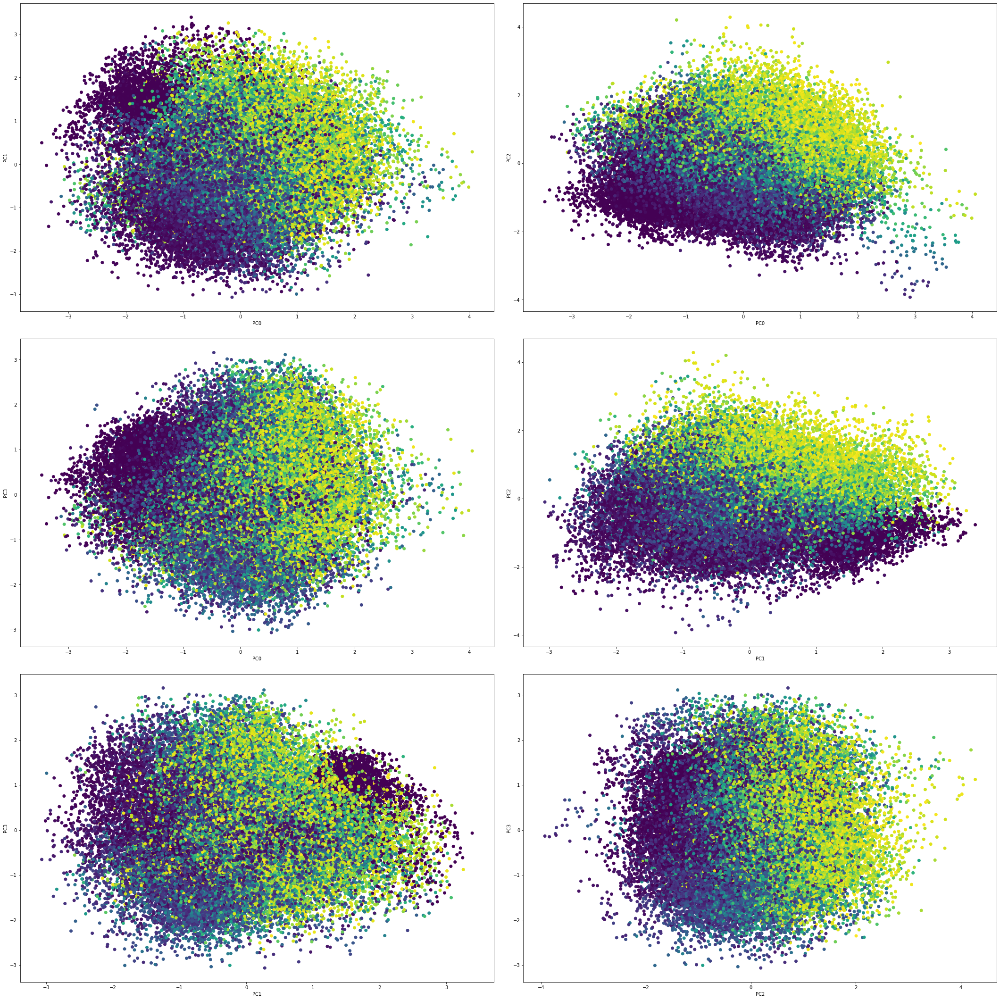

In [2]:
inputPIV = np.load("PIV_r0_50k.npy")
latent = np.load("LatentSpace.npy")
pca = PCA()
pca.fit(latent)
projected_latentspace = pca.transform(latent)

fig, axes = plt.subplots(3, 2, figsize=(30, 30))
k=0
for i in range(3):
    for j in range(i+1,4):
        #m = i*3 + j \n",
        m = int(np.floor(k/2))
        axes[m][k%2].scatter(projected_latentspace.T[i], projected_latentspace.T[j], c=inputPIV.T[7]) #, vmin = 0.3, vmax = 0.7)\n",
        #axes.scatter(projected_latentspace.T[0][6760], projected_latentspace.T[1][6760], c=\"red\")\n",
        #clb = plt.colorbar(s1)\n",
        #clb.ax.set_title(\"Cl-Waters Avg. PIV (z-score)\", pad=20)\n",
        plt.rcParams.update({'font.size': 25})
        #axes.set_title(\"i:%d; j:%d; k:%d\" %(i,j,k))\n",
        axes[m][k%2].set_ylabel("PC%d" %j)
        axes[m][k%2].set_xlabel("PC%d" %i)
        k += 1
plt.tight_layout()
plt.show()

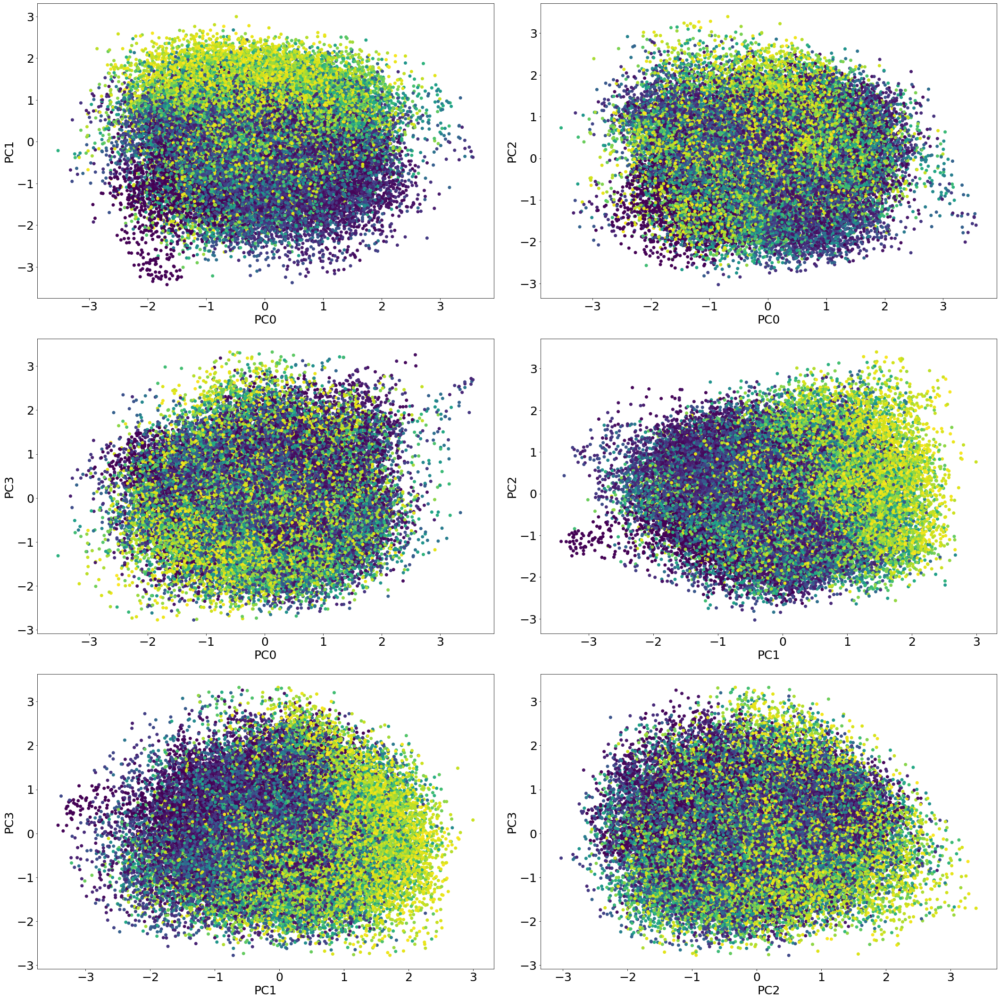

In [4]:
fig, axes = plt.subplots(3, 2, figsize=(30, 30))
k=0
for i in range(3):
    for j in range(i+1,4):
        #m = i*3 + j \n",
        m = int(np.floor(k/2))
        axes[m][k%2].scatter(latent.T[i], latent.T[j], c=inputPIV.T[7]) #, vmin = 0.3, vmax = 0.7)\n",
        #axes.scatter(projected_latentspace.T[0][6760], projected_latentspace.T[1][6760], c=\"red\")\n",
        #clb = plt.colorbar(s1)\n",
        #clb.ax.set_title(\"Cl-Waters Avg. PIV (z-score)\", pad=20)\n",
        plt.rcParams.update({'font.size': 25})
        #axes.set_title(\"i:%d; j:%d; k:%d\" %(i,j,k))\n",
        axes[m][k%2].set_ylabel("PC%d" %j)
        axes[m][k%2].set_xlabel("PC%d" %i)
        k += 1
plt.tight_layout()
plt.show()

Text(0.5, 0, 'PCs')

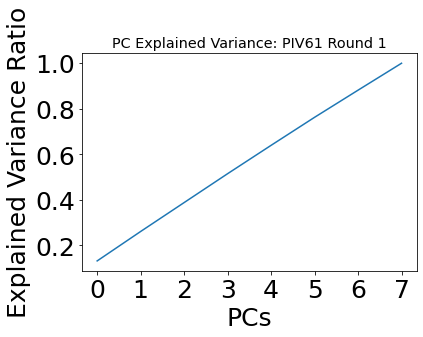

In [5]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.rcParams.update({'font.size': 12})
plt.title("PC Explained Variance: PIV61 Round 1")
plt.ylabel("Explained Variance Ratio")
plt.xlabel("PCs")

In [24]:
pca.components_

array([[-0.33074284, -0.40789086, -0.21778774,  0.42601568,  0.4805305 ,
         0.4150102 ,  0.03219324,  0.30188343],
       [-0.38611484, -0.02517641, -0.08247799, -0.11144257, -0.5025767 ,
         0.01193385, -0.58440435,  0.48662612],
       [ 0.10615359, -0.15534101,  0.45917243,  0.23065718, -0.552301  ,
         0.4452681 ,  0.42343238,  0.13402809],
       [ 0.5604349 , -0.580123  , -0.03365248,  0.09337324, -0.08844876,
         0.09757538, -0.5015582 , -0.2657327 ],
       [ 0.62456864,  0.35447243, -0.01956758, -0.00406324,  0.2124492 ,
         0.12909338, -0.06630993,  0.64627135],
       [ 0.15342401, -0.14229855, -0.8149011 , -0.07480042, -0.3529241 ,
        -0.04077487,  0.39438355,  0.06926043],
       [-0.01045064,  0.56727725, -0.2629128 ,  0.34980166, -0.1233696 ,
         0.5006826 , -0.25782433, -0.39271688],
       [-0.0493347 , -0.06792841, -0.01497255, -0.7849823 ,  0.1368845 ,
         0.5923081 ,  0.0130703 , -0.08242388]], dtype=float32)

In [25]:
pca.components_[:2]

array([[-0.33074284, -0.40789086, -0.21778774,  0.42601568,  0.4805305 ,
         0.4150102 ,  0.03219324,  0.30188343],
       [-0.38611484, -0.02517641, -0.08247799, -0.11144257, -0.5025767 ,
         0.01193385, -0.58440435,  0.48662612]], dtype=float32)